In [1]:
### libs
import pandas as pd
import numpy as np
import os
from tqdm.notebook import tqdm

In [2]:
### custom funcs
def normalize_array(array):
    # Flatten the array and normalize
    array_flat = array.flatten()
    array_min = np.min(array_flat)
    array_max = np.max(array_flat)
    array_norm = (array_flat - array_min) / (array_max - array_min)
    # Reshape to original shape
    # array_norm = array_norm.reshape(array.shape)  

    return array_norm

def transform_distribution(values, cent):
    transformed_values = np.zeros_like(values)  
 
    mask1 = values <= cent
    transformed_values[mask1] = (values[mask1] / cent) * 0.5
    
    mask2 = values > cent
    transformed_values[mask2] = ((values[mask2] - cent) / 0.31) * 0.5 + 0.5
    
    return transformed_values


#---------------------------------------------
def find_max_element(sum_text, sum_vis):
    # Find the unique elements in sum_text sorted in ascending order
    max_val = np.max(sum_text)
    min_val = np.min(sum_text)

    # Find indices of the second biggest element
    second_biggest_indices = np.where((sum_text > min_val) & (sum_text < max_val))[0]
    
    # From these indices, find the one with the maximum value in sum_vis
    max_vis_index = second_biggest_indices[np.argmax(sum_vis[second_biggest_indices])]

    # Replace the second biggest element in sum_text and corresponding element in sum_vis
    sum_text[max_vis_index] = 100
    sum_vis[max_vis_index] = -1

    return max_vis_index, sum_text, sum_vis

def find_min_element(sum_text, sum_vis):
    min_indices = np.where(sum_text == np.min(sum_text))[0]
    min_element = min_indices[np.argmin(sum_vis[min_indices])]
    return min_element, sum_text, sum_vis

In [3]:
### plotting settings
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rc('image', cmap='viridis')

plt.rcParams.update({
    "font.family": "serif",  
    # use serif/main font for text elements
    })
plt.rcParams.update({'font.size': 20})
plt.rcParams.update({'font.weight': 'bold'})
plt.rcParams.update({'axes.linewidth': 2.5})
plt.rcParams.update({'axes.labelweight': 'bold'})
plt.rcParams.update({'axes.labelsize': 20})
plt.rc('legend',fontsize=12)

def plot_images(paths):
    num_images = len(paths)
    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 5, 5))
    
    for i, path in enumerate(paths):
        img = mpimg.imread(path)
        axes[i].imshow(img)
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

In [4]:
### paths & vars

# substitute with a path where all of your images are
#!! the images should NOT be in separated paths
image_path = '/projects/crunchie/boyanova/EEG_Things/data_set/Images_all' 

names = os.listdir(image_path)
image_paths = []
for im_idx in tqdm(range(len(names))):
    image_paths.append((os.path.join(image_path, names[im_idx])))

#!! I simulate captions    
captions = ["There is a {} in the image".format(x[0:-8]) for x in names]

#!! these are specifics for my case
photo_jig_ids = [idx for idx, x in enumerate(names) if x[0:-8] in ["photo_booth", "jigsaw_puzzle"]]
keep = [x for x in np.arange(len(names)) if x not in photo_jig_ids]

# final sample
captions = np.array(captions)[keep]
image_paths = np.array(image_paths)[keep]

  0%|          | 0/26107 [00:00<?, ?it/s]

In [5]:
### fetch data
image_embeddings = np.load("CLIP_VisionThings.npy")
text_embeddings = np.load("CLIP_TextThings.npy")

In [6]:
### get Similarity matrices
image_image = np.round(np.matmul(image_embeddings, image_embeddings.T), 2)
text_text = np.round(np.matmul(text_embeddings, text_embeddings.T),2)
image_text = np.round(np.matmul(image_embeddings, text_embeddings.T),2)

In [7]:
### normalize and compute 
image_image_norm = normalize_array(image_image)
text_text_norm = normalize_array(text_text)

text_text_centered = transform_distribution(text_text_norm, np.mean(text_text_norm))
image_image_centered = transform_distribution(image_image_norm, np.mean(image_image_norm))

test = (image_image_centered - text_text_centered) 
test2 = (image_image_centered + text_text_centered)

difference_mat = test.reshape(image_image.shape[0], image_image.shape[1])
summation_mat = test2.reshape(image_image.shape[0], image_image.shape[1])

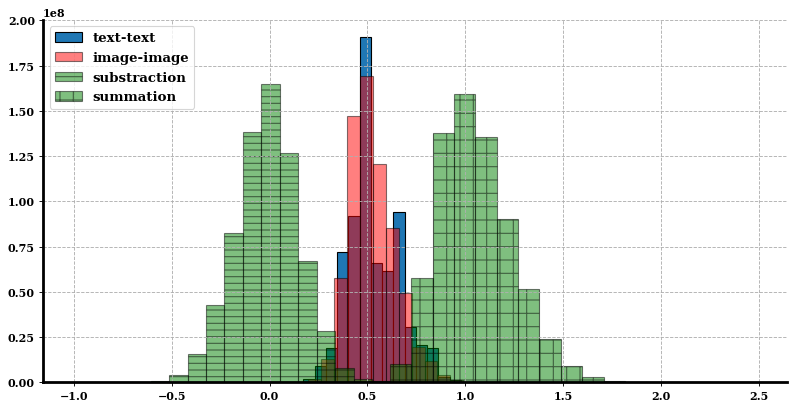

In [8]:
### visualize mats to make sense 
plt.figure(figsize=(12, 6), dpi=80)
plt.grid(True, linestyle = "--")
plt.hist(text_text_centered, bins = 20, edgecolor='black', label = "text-text")
plt.hist(image_image_centered, bins = 20, edgecolor='black', alpha = 0.5, color = "red", label = "image-image")
plt.hist(test, bins = 20, edgecolor = "black", color = "green", hatch='--', alpha = 0.5, label = "substraction")
plt.hist(test2, bins = 20, edgecolor = "black", color = "green", hatch='+', alpha = 0.5, label = "summation")
plt.legend(loc = "upper left")

## Similar-Similar Grouping

In [19]:
pick_cat = "elephant"
# set threshold above 1.3 seems approp
arr = np.array(np.where(summation_mat > 1.3)).T

# set number of elements you want in the group 
num_elements = 5

# number of starting categories 
uniq_start = np.unique(arr[:, 0])

# empty var + the categoriy(ies) of interest
sim_sim_results = []
cat_ids_sim = [idx for idx, x in enumerate(np.array(names)) if x[0:-8] == pick_cat]

for u_i in tqdm(cat_ids_sim):
    # Step 1: Select the rows corresponding to the unique start index
    rows_first_col = arr[arr[:, 0] == uniq_start[u_i]][:, 1]
    if u_i in rows_first_col:
        rows_first_col = np.delete(rows_first_col, np.where(rows_first_col == u_i))
    rows_first_col = np.insert(rows_first_col, 0, u_i, axis=0)

    # Step 2: Calculate similarity matrices
    sim_mat_text = np.matmul(text_embeddings[rows_first_col], text_embeddings[rows_first_col].T)
    sim_mat_vis = np.matmul(image_embeddings[rows_first_col], image_embeddings[rows_first_col].T)

    #Step 3:  Initialize sum_text and sum_vis with the first row
    sum_text = sim_mat_text[0, :]
    sum_vis = sim_mat_vis[0, :]

    elements = [0]

    for el_x in range(num_elements):
        element, sum_text, sum_vis = find_max_element(sum_text, sum_vis)
        sum_text += sim_mat_text[element, :]
        sum_vis += sim_mat_vis[element, :]
        elements.append(element)

        if el_x == 0:
            sum_text[0] = -1
            sum_vis[0] = -1

    sim_sim_results.append([np.array(image_paths)[rows_first_col[i]] for i in elements])

name = "{}_sim_sim.npy".format(pick_cat)
np.save(name, np.array(sim_sim_results))
print("File {} saved!".format(name))

  0%|          | 0/12 [00:00<?, ?it/s]

File elephant_sim_sim.npy saved!


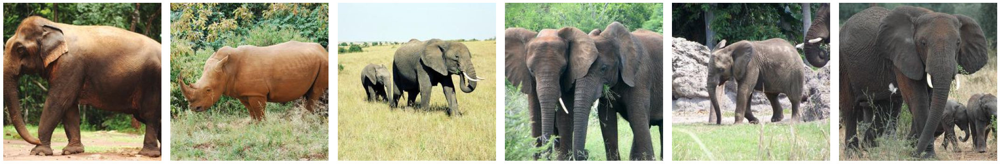

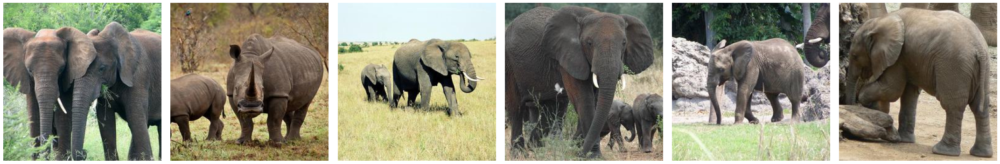

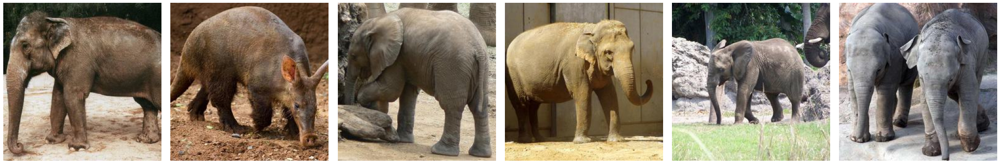

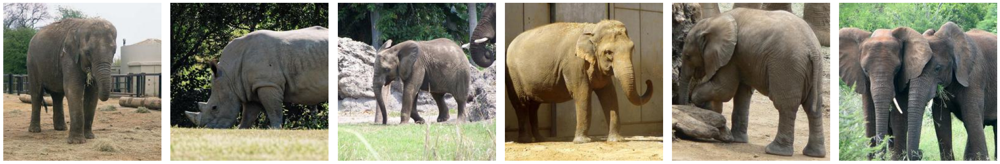

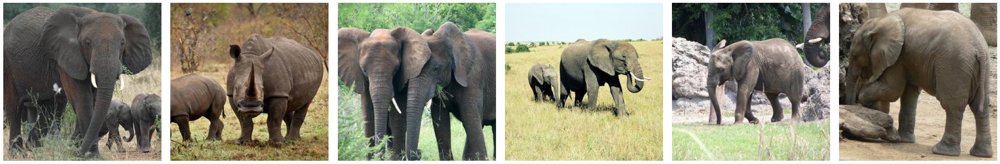

In [16]:
# show some examples
for x in range(5):
    plot_images(sim_sim_results[x])

## Dissimilar-Dissimilar Grouping

In [18]:
arr = np.array(np.where(summation_mat < 0.87)).T
uniq_start = np.unique(arr[:, 0])

dissim_dissim_results = []
for u_i in tqdm(cat_ids_sim):
    # Step 1: Select the rows corresponding to the unique start index
    rows_first_col = arr[arr[:, 0] == uniq_start[u_i]][:, 1]
    rows_first_col = np.insert(rows_first_col, 0, u_i, axis=0)

    # Step 2: Calculate similarity matrices
    sim_mat_text = np.matmul(text_embeddings[rows_first_col], text_embeddings[rows_first_col].T)
    sim_mat_vis = np.matmul(image_embeddings[rows_first_col], image_embeddings[rows_first_col].T)

    #Step 3:  Initialize sum_text and sum_vis with the first row
    sum_text = sim_mat_text[0, :]
    sum_vis = sim_mat_vis[0, :]

    elements = [0]

    for el_x in range(num_elements):
        element, sum_text, sum_vis = find_min_element(sum_text, sum_vis)
        sum_text += sim_mat_text[element, :]
        sum_vis += sim_mat_vis[element, :]
        elements.append(element)


    dissim_dissim_results.append([np.array(image_paths)[rows_first_col[i]] for i in elements])
    
name = "{}_dissim_dissim.npy".format(pick_cat)
np.save(name, np.array(dissim_dissim_results))
print("File {} saved!".format(name))    

  0%|          | 0/12 [00:00<?, ?it/s]

File elephant_dissim_dissim.npy saved!


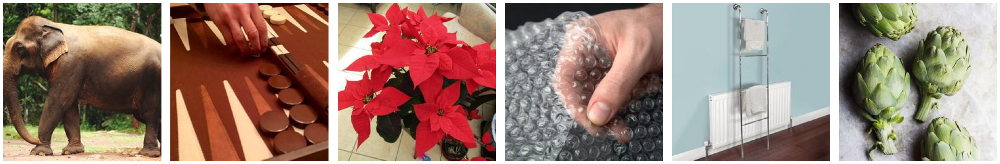

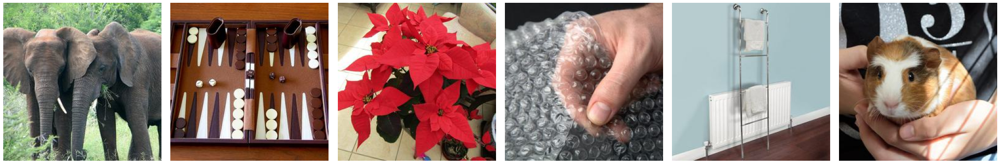

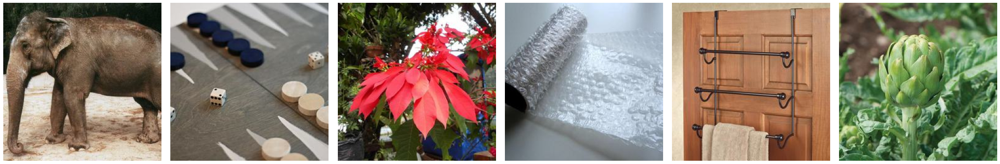

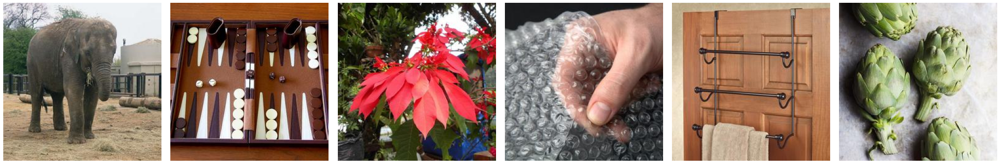

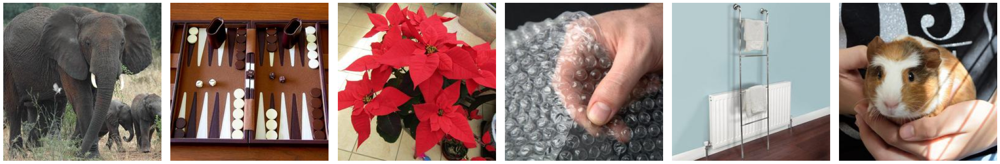

In [20]:
# show some examples
for x in range(5):
    plot_images(dissim_dissim_results[x])


## Similar-Similar Grouping with class variability

In [21]:
pick_cat = "elephant"
# set threshold above 1.3 seems approp
arr = np.array(np.where(summation_mat > 1.3)).T

# set number of elements you want in the group 
num_elements = 5

# number of starting categories 
uniq_start = np.unique(arr[:, 0])

# empty var + the categoriy(ies) of interest
sim_sim_results = []
cat_ids_sim = [idx for idx, x in enumerate(np.array(names)) if x[0:-8] == pick_cat]

for u_i in tqdm(cat_ids_sim):
    # Step 1: Select the rows corresponding to the unique start index
    rows_first_col = arr[arr[:, 0] == uniq_start[u_i]][:, 1]
    if u_i in rows_first_col:
        rows_first_col = np.delete(rows_first_col, np.where(rows_first_col == u_i))

    # Step 2: Get rid of matching classes
    classes = [x.split(".")[0][0:-4] for x in np.array(names)]
    rows_first_col = [val for idx, val in enumerate(rows_first_col) if classes[rows_first_col[idx]] != classes[u_i]]
    rows_first_col = np.insert(rows_first_col, 0, u_i, axis=0)
    mask = np.zeros(len(rows_first_col), dtype=bool)
  
    # Step 3: Calculate similarity matrices
    sim_mat_text = np.matmul(text_embeddings[rows_first_col], text_embeddings[rows_first_col].T)
    sim_mat_vis = np.matmul(image_embeddings[rows_first_col], image_embeddings[rows_first_col].T)

    #Step 4:  Initialize sum_text and sum_vis with the first row
    sum_text = sim_mat_text[0, :]
    sum_vis = sim_mat_vis[0, :]

    elements = [0]
    for el_x in range(num_elements):
        element, sum_text, sum_vis = find_max_element(sum_text, sum_vis)

        class_filter = [idx for idx in range(len(rows_first_col)) if classes[rows_first_col[idx]] == np.array(classes)[rows_first_col[element]]]
        mask[class_filter] = True

        sum_text += sim_mat_text[element, :]
        sum_vis += sim_mat_vis[element, :]

        sum_text[mask] = 0.0
        sum_vis[mask] = 0.0

        elements.append(element)
                
    sim_sim_results.append([np.array(image_paths)[rows_first_col[i]] for i in elements])

name = "{}_sim_sim_var.npy".format(pick_cat)
np.save(name, np.array(sim_sim_results))
print("File {} saved!".format(name))

  0%|          | 0/12 [00:00<?, ?it/s]

File elephant_sim_sim_var.npy saved!


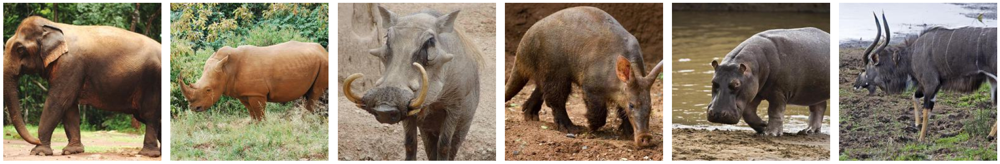

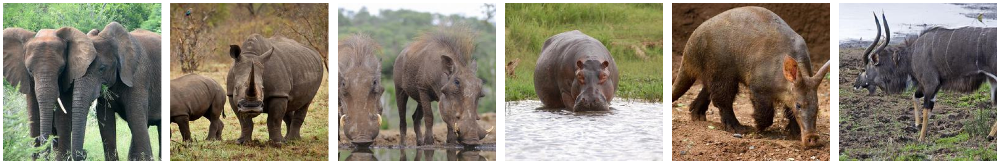

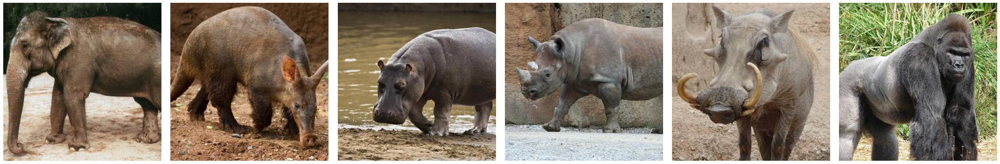

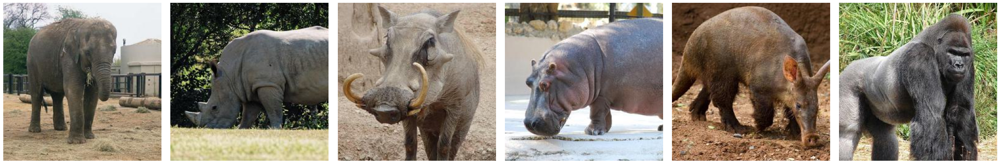

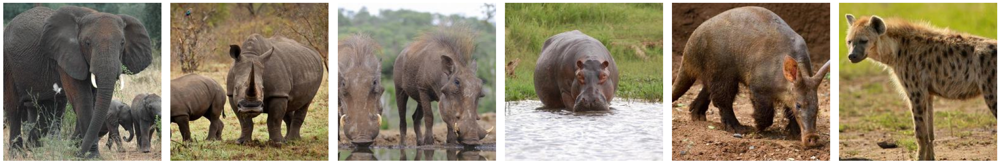

In [22]:
# show some examples
for x in range(5):
    plot_images(sim_sim_results[x])